# **GradCAM**
**Apply gradient-weighted Class Activation Maps to visualise how neural network perceive the classified object and what parts of picture really matters to its perception. GradCAM is used to check if tested network classifies with correct reasoning. It's a reverse way to search for incorrectness in dataset.**

*I find it fascinating to understand how AI can perceive visual inputs. Does the gestalt principles apply to deep learning similarly to human perception? What does it mean to percive an object?*

[Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/pdf/1610.02391.pdf) by Selvaraju, Cogswell, Das, Vedantam, Parikh & Batra (2019)



In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_hub as hub

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import numpy as np

## 1. Dataset
For the purpose of this task I'm using Cats vs Dogs dataset available via Tensorflow Datasets.*italicized text*

### 1.1 Load the dataset

In [ ]:
DATASET_SPLIT = ['train[:80%]', 'train[80%:90%]', 'train[90%:]']

dataset, info = tfds.load('cats_vs_dogs', split=DATASET_SPLIT, as_supervised=True, with_info=True)

train_dataset, test_dataset, val_dataset = dataset

NUM_EXAMPLES = info.splits['train'].num_examples
NUM_CLASSES = info.features['label'].num_classes

print(f"Number of images: {NUM_EXAMPLES}")
print(f"Number of classes: {NUM_CLASSES} (It's just a basic classifier)")

Number of images: 23262
Number of classes: 2 (It's just a basic classifier)


### 1.2 Preprocess the images in dataset

In [ ]:
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 32

def preprocess(image, label):
    image = tf.image.resize(image, IMAGE_SIZE)
    image /= 255.0
    return image, label


train_batches = train_dataset.shuffle(NUM_EXAMPLES // 4)
train_batches = train_batches.map(preprocess)
train_batches = train_batches.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

test_batches = test_dataset.map(preprocess).batch(1)

val_batches = val_dataset.map(preprocess)
val_batches = val_batches.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

## 2. Model
**The model uses transfer learning from VGG16 and imagenet weights** with additional layers for binary classification.

### 2.1 Create model class
*I've been trying to define the model as a class but it has troubles in passing the shape between VGG16 and AvgPool layers which later produced some errors I couldn't debug.*

In [ ]:
INPUT_SIZE = IMAGE_SIZE + (3,)

def create_model(shape=INPUT_SIZE, lr=0.001):
    base_model = tf.keras.applications.VGG16(input_shape=shape, weights='imagenet', include_top=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
    output = tf.keras.layers.Dense(2, activation='softmax')(x)

    model = tf.keras.models.Model(inputs=base_model.input, outputs=output)
    
    for layer in base_model.layers[:-4]:
        layer.trainable = False

    model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=lr),
        loss=tf.keras.losses.sparse_categorical_crossentropy,
        metrics=['accuracy']
    )
        
    return model


### 2.2 Compile

In [ ]:
model = create_model()
model.summary()

Model: "model_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_46 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0  

### 2.3 Train

In [ ]:
EPOCHS = 3
model.fit(train_batches, epochs=EPOCHS, validation_data=val_batches)

Epoch 1/3
582/582 [==============================] - 108s 174ms/step - loss: 0.8567 - accuracy: 0.7830 - val_loss: 0.1035 - val_accuracy: 0.9600
Epoch 2/3
582/582 [==============================] - 105s 170ms/step - loss: 0.1492 - accuracy: 0.9476 - val_loss: 0.1339 - val_accuracy: 0.9458
Epoch 3/3
582/582 [==============================] - 103s 170ms/step - loss: 0.1006 - accuracy: 0.9630 - val_loss: 0.0825 - val_accuracy: 0.9686


## 3. GradCam
**Generate the class activation maps.**

In [ ]:
# LAYERS_TO_VISUALIZE = 

# model.base_model.summary()

LAYER_NAMES = [layer.output for layer in model.layers[1:18]]

visualization_model = tf.keras.models.Model(model.input, LAYER_NAMES)

# print("Layers to visualize", LAYER_NAMES)

# # LAYER_NAMES = []

layer_names = []

print("Layers to visualize")
for layer in LAYER_NAMES:
    layer_names.append(layer.name.split("/")[0])

print(layer_names)

# print(layer_names)
# print([layer.name for layer in model.layers[1:18]])

Layers to visualize
['block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3']


In [ ]:

def get_CAM(processed_image, actual_label, layer_name='block5_conv3'):

    model_grad = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])


    with tf.GradientTape() as tape:
        conv_output_values, predictions = model_grad(processed_image)

        tape.watch(conv_output_values)

        pred_prob = predictions[:,1] 
        actual_label = tf.cast(actual_label, dtype=tf.float32)
        
        smoothing = 0.00001 
        

        loss = -1 * (actual_label * tf.math.log(pred_prob + smoothing) + (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))
        print(f"binary loss: {loss}")
    
    # get the gradient of the loss with respect to the outputs of the last conv layer
    grads_values = tape.gradient(loss, conv_output_values)
    grads_values = tf.keras.backend.mean(grads_values, axis=(0,1,2))
    
    conv_output_values = np.squeeze(conv_output_values.numpy())
    grads_values = grads_values.numpy()
    
    print(conv_output_values.shape)
    for i in range(512): 
        conv_output_values[:,:,i] *= grads_values[i]
        
    heatmap = np.mean(conv_output_values, axis=-1)
    
    heatmap = np.maximum(heatmap, 0)
    heatmap /= heatmap.max()
    
    del model_grad, conv_output_values, grads_values, loss
   
    return heatmap

In [ ]:
def show_sample(idx=None):
    
    # if image index is specified, get that image
    if idx:
        for img, label in test_batches.take(idx):
            sample_image = img[0]
            sample_label = label[0]
    # otherwise if idx is not specified, get a random image
    else:
        for img, label in test_batches.shuffle(1000).take(1):
            sample_image = img[0]
            sample_label = label[0]
    
    sample_image_processed = np.expand_dims(sample_image, axis=0)
    
    activations = visualization_model.predict(sample_image_processed)
    
    pred_label = np.argmax(model.predict(sample_image_processed), axis=-1)[0]
    
    sample_activation = activations[0][0,:,:,16]
    
    sample_activation-=sample_activation.mean()
    sample_activation/=sample_activation.std()
    
    sample_activation *=255
    sample_activation = np.clip(sample_activation, 0, 255).astype(np.uint8)
    
    heatmap = get_CAM(sample_image_processed, sample_label)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
    converted_img = sample_image.numpy()
    super_imposed_image = cv2.addWeighted(converted_img, 0.8, heatmap.astype('float32'), 2e-3, 0.0)

    f,ax = plt.subplots(2,2, figsize=(15,8))

    ax[0,0].imshow(sample_image)
    ax[0,0].set_title(f"True label: {sample_label} \n Predicted label: {pred_label}")
    ax[0,0].axis('off')
    
    ax[0,1].imshow(sample_activation)
    ax[0,1].set_title("Random feature map")
    ax[0,1].axis('off')
    
    ax[1,0].imshow(heatmap)
    ax[1,0].set_title("Class Activation Map")
    ax[1,0].axis('off')
    
    ax[1,1].imshow(super_imposed_image)
    ax[1,1].set_title("Activation map superimposed")
    ax[1,1].axis('off')
    plt.tight_layout()
    plt.show()
  
    return activations

1/1 [==============================] - 0s 19ms/step
binary loss: [0.5023726]
(14, 14, 512)


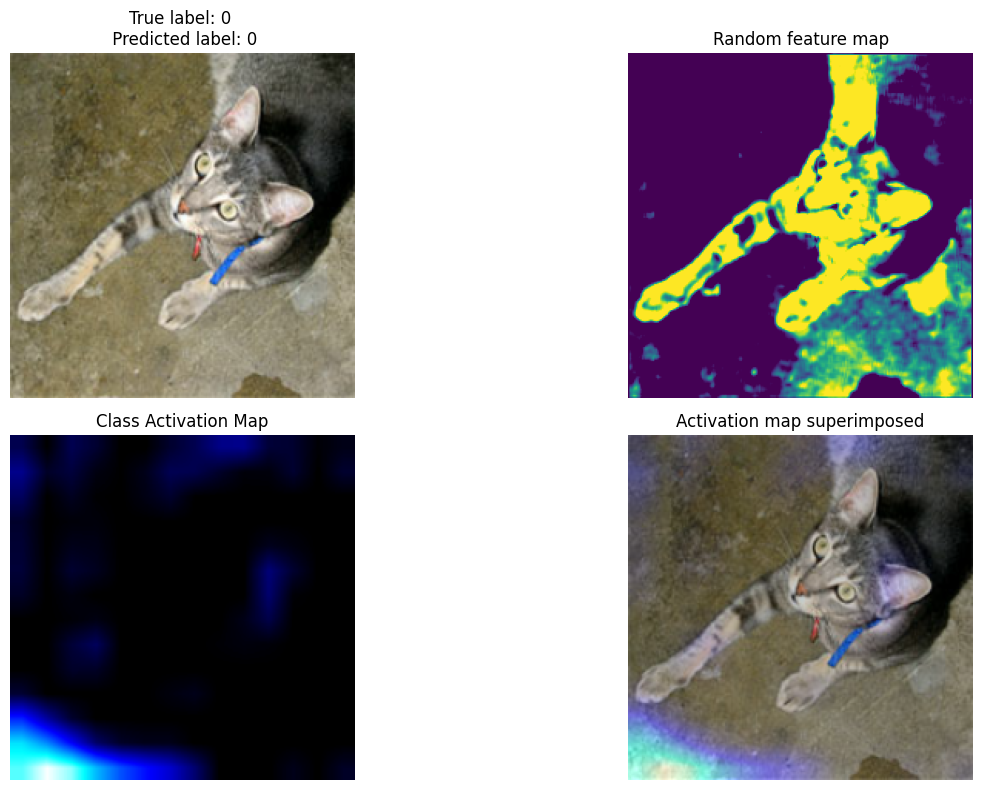

In [ ]:
# Choose an image index to show, or leave it as None to get a random image


activations = show_sample(idx=None)

In [ ]:
def visualize_intermediate_activations(layer_names, activations):
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16
    
    for layer_name, layer_activation in zip(layer_names, activations):
        nb_features = layer_activation.shape[-1]
        size= layer_activation.shape[1]

        nb_cols = nb_features // images_per_row
        grid = np.zeros((size*nb_cols, size*images_per_row))

        for col in range(nb_cols):
            for row in range(images_per_row):
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *=255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()

<ipython-input-145-64cb55a4b5f5>:16: RuntimeWarning: invalid value encountered in true_divide
  feature_map /= feature_map.std()


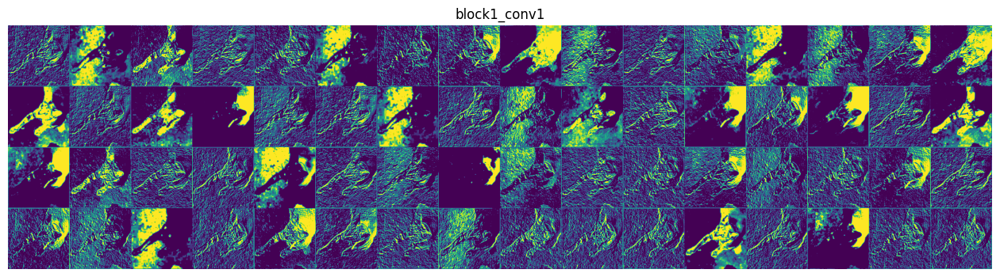

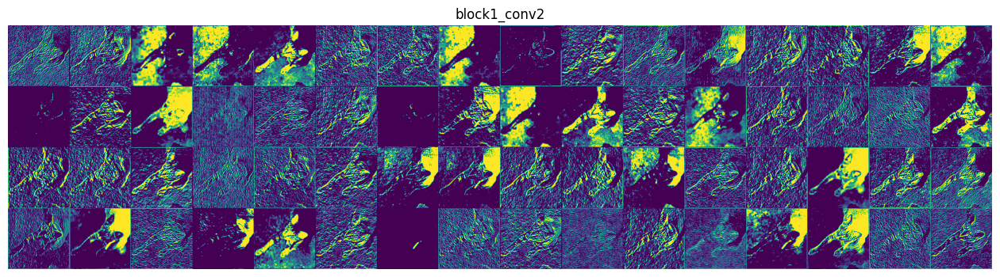

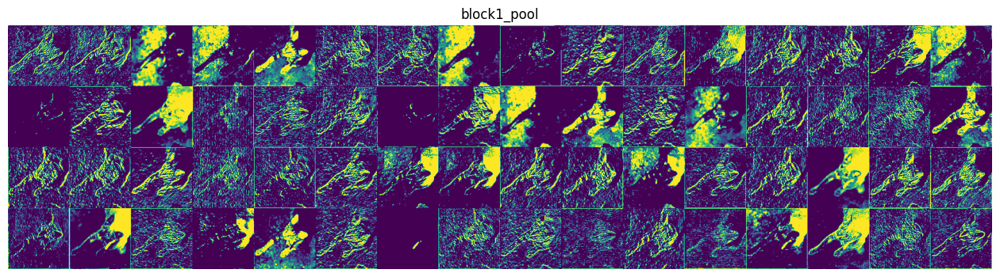

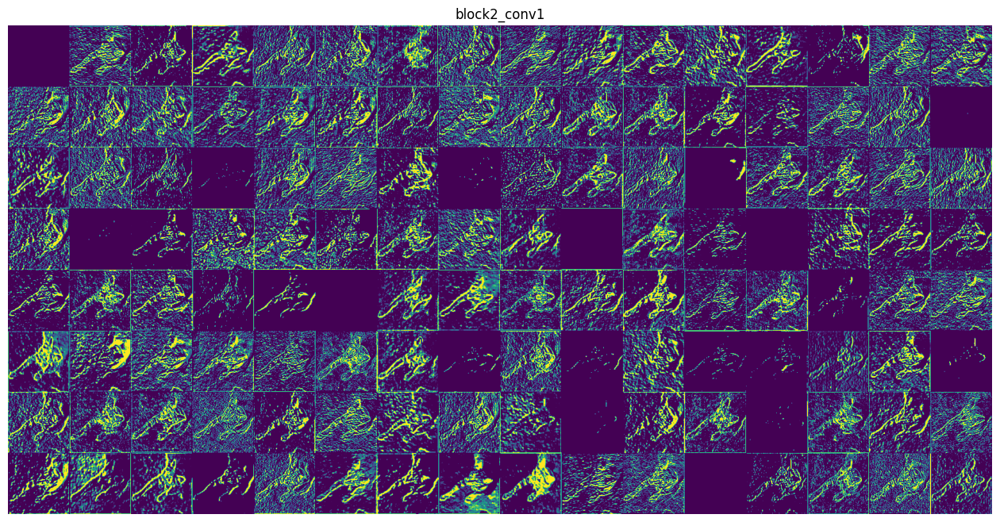

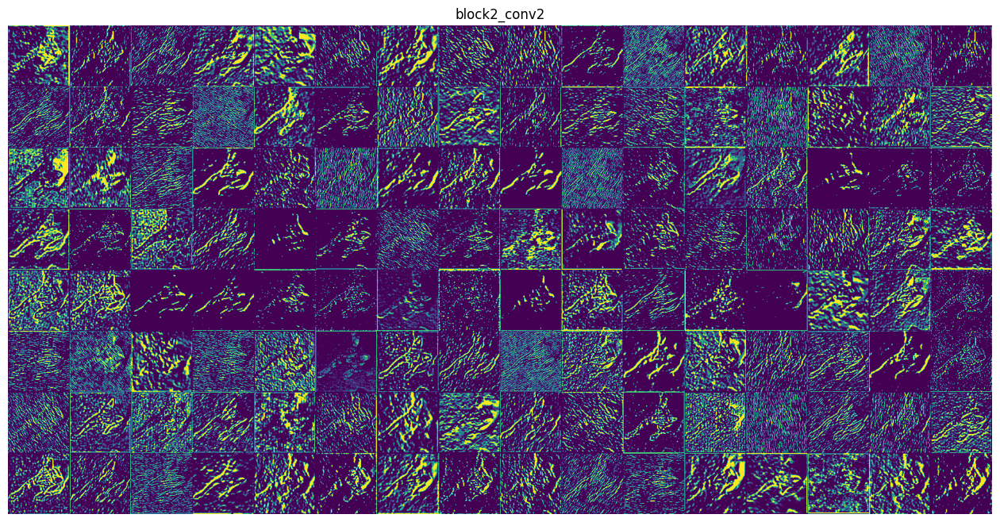

...

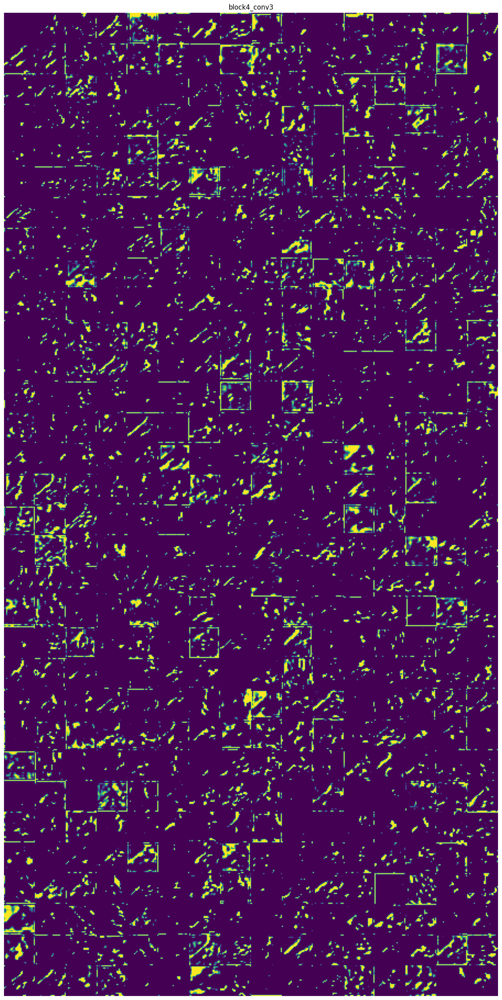

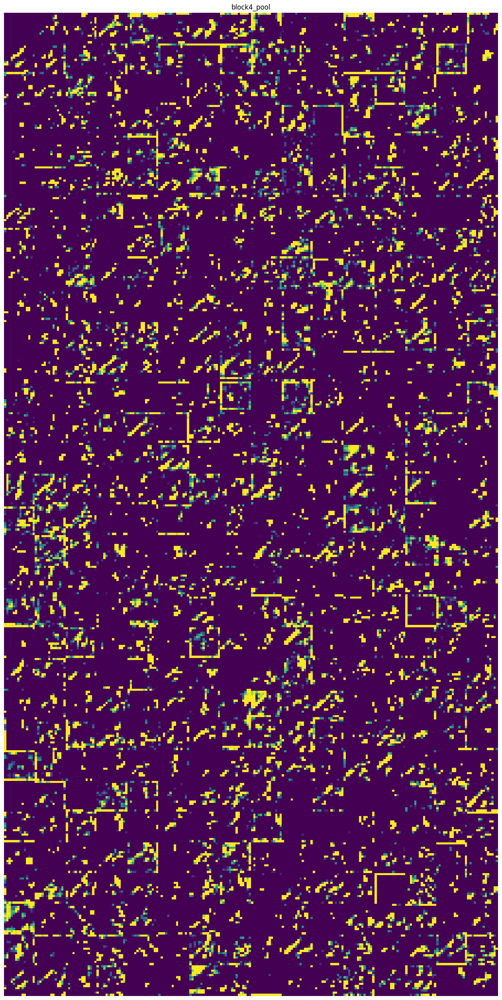

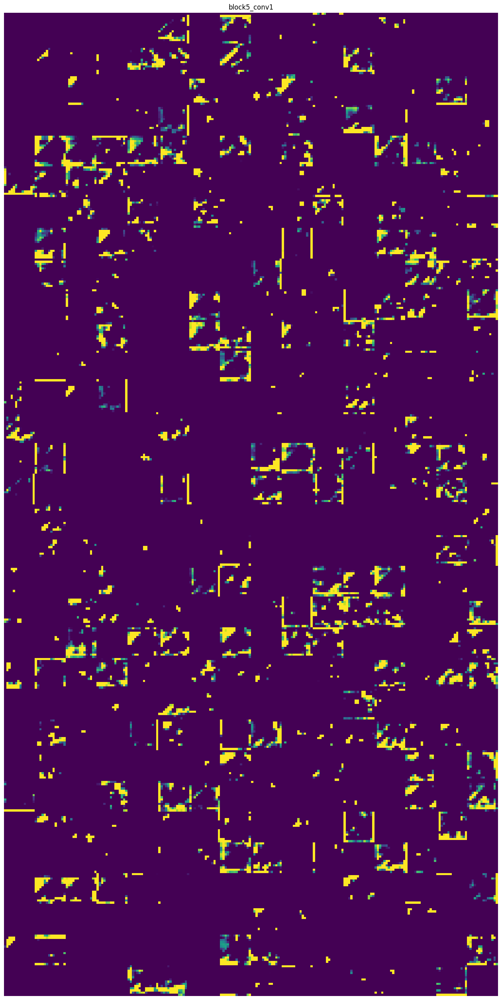

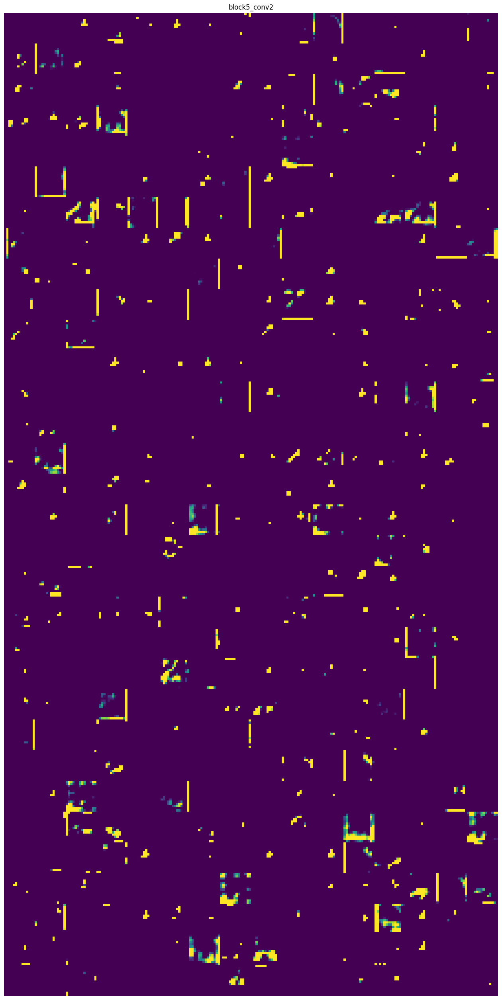

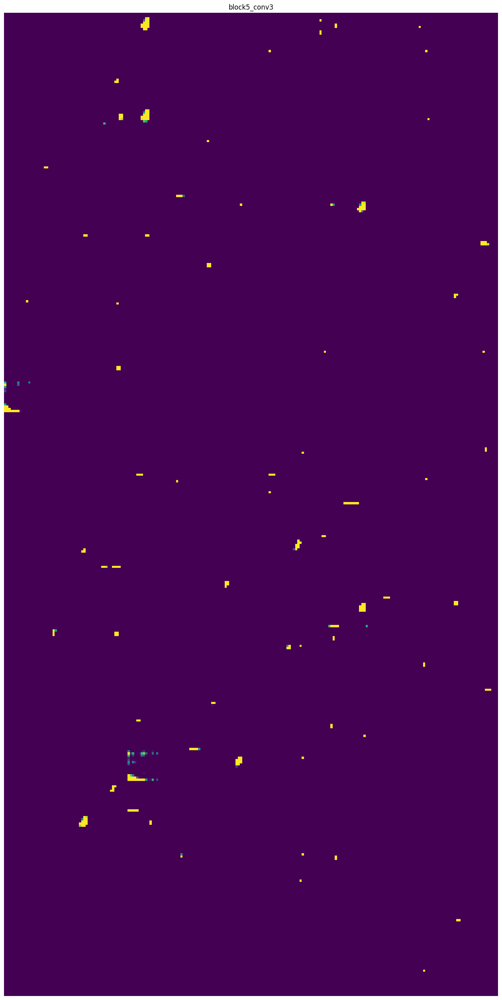

In [ ]:
visualize_intermediate_activations(activations=activations, 
                                   layer_names=layer_names)